In [ ]:
#라이브러리 설치
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 709.3/709.3 kB 4.5 MB/s eta 0:00:00


In [ ]:
#ultralytics 가져오기
import ultralytics

ultralytics.checks()

Ultralytics YOLOv8.1.9 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 28.6/107.7 GB disk)


# 테스트 이미지 display

In [ ]:
from PIL import Image
from IPython.display import display

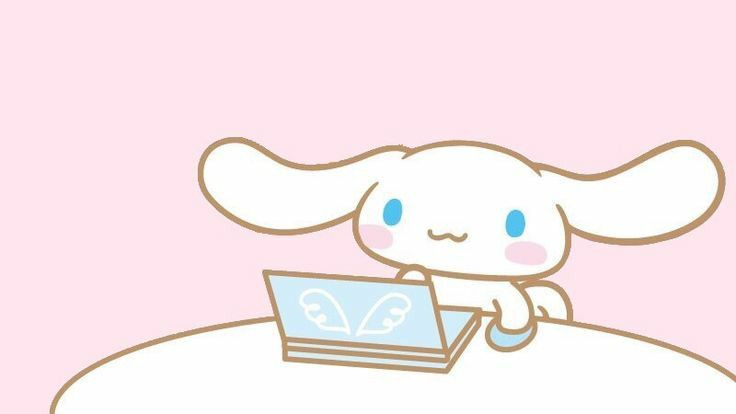

In [ ]:
# 이미지 파일을 열고
with Image.open("/content/b.jpg") as test_image1:
    # 이미지를 display 함수를 사용하여 표시합니다.
    display(test_image1)

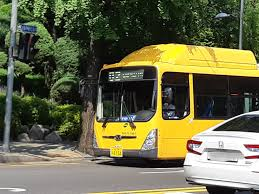

In [ ]:
#두번째 테스트 이미지 display
with Image.open("/content/bus.jpg") as test_image2:
    display(test_image2)

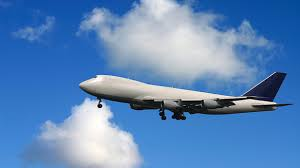

In [ ]:
#세번째 테스트 이미지 display
with Image.open("/content/plane.png") as test_image3:
    display(test_image3)

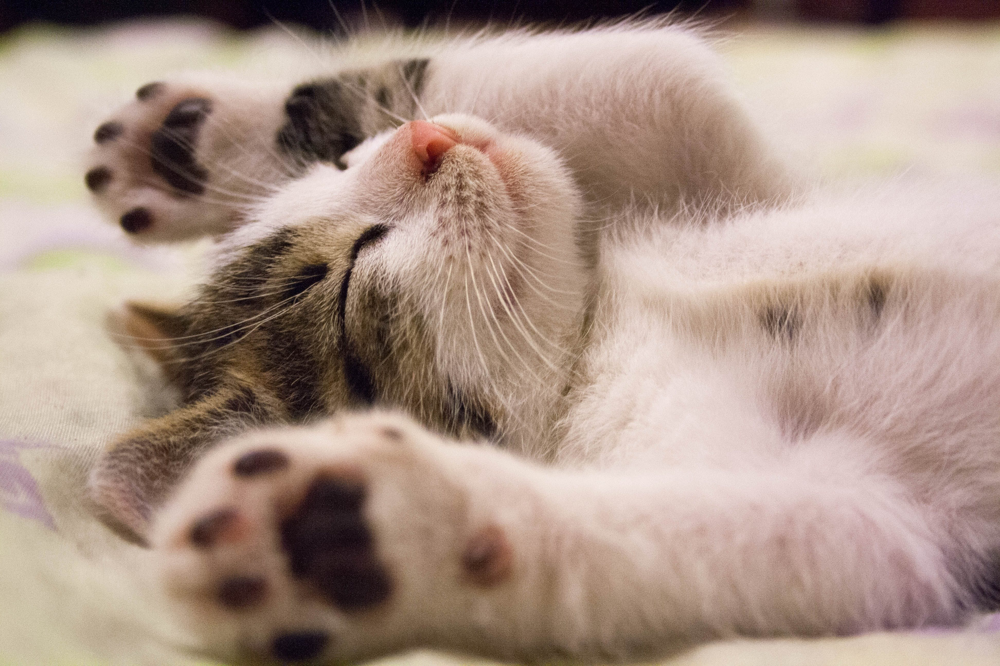

In [ ]:
#네번째 테스트 이미지 display
with Image.open("/content/kitten.jpg") as test_image4:
    display(test_image4)

# 객체 탐지

In [ ]:
#YOLO 모듈 가져오기
from ultralytics import YOLO

# MS COCO 데이터셋 사전학습된 yolov8 모델 로드함
model = YOLO("yolov8n.pt")

100%|██████████| 6.23M/6.23M [00:00<00:00, 81.4MB/s]


In [ ]:
# MS COCO 데이터셋에 정의되어 있는 클래스 개수와 종류를 확인
print(model.names)
print(len(model.names))

{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microw

# 테스트 이미지에서 객체 탐지

In [ ]:
#예측 하기
#예측 결과 파일의 위치 : Results saved to runs/detect/predict

results1 = model.predict(source="*.jpg", save=True)
results2 = model.predict(source="*.png", save=True)


image 1/3 /content/b.jpg: 384x640 (no detections), 167.3ms
image 2/3 /content/bus.jpg: 480x640 1 person, 1 car, 1 bus, 165.8ms
image 3/3 /content/kitten.jpg: 448x640 1 cat, 151.6ms
Speed: 3.6ms preprocess, 161.6ms inference, 2.2ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/detect/predict

image 1/2 /content/frog.png: 640x640 (no detections), 221.8ms
image 2/2 /content/plane.png: 384x640 1 airplane, 201.3ms
Speed: 3.7ms preprocess, 211.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/detect/predict


In [ ]:
from PIL import Image
from IPython.display import display

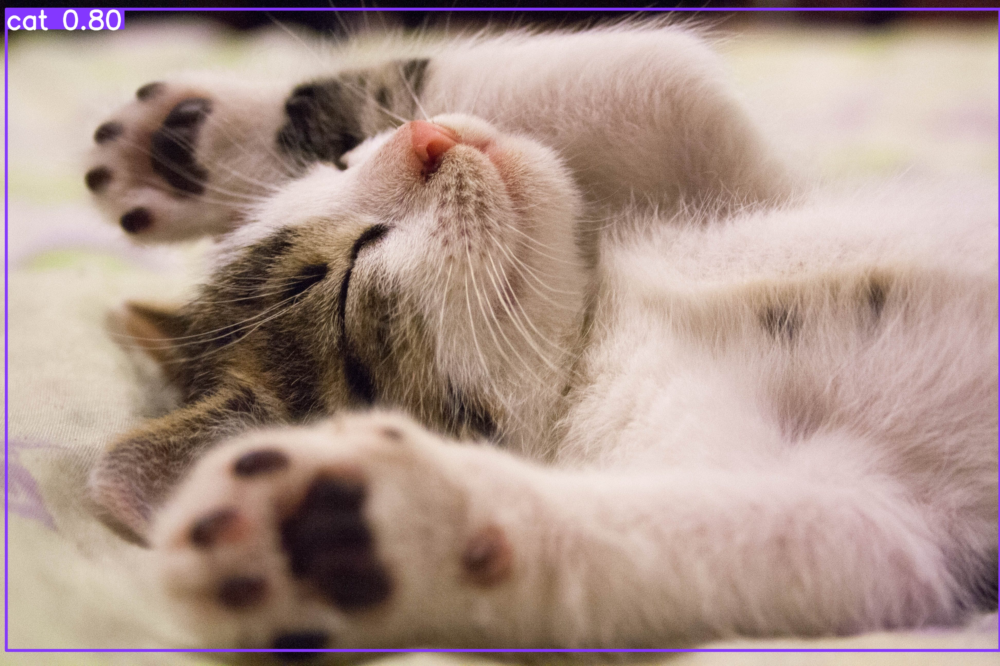

In [ ]:
#첫번째 예측 이미지 display
#with Image.open('/content/runs/detect/predict/test1.jpg') as pred_image:
with Image.open("/content/runs/detect/predict/kitten.jpg") as pred_img:
  display(pred_img)

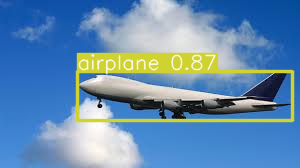

In [ ]:
#두번째 예측 이미지 display
#with Image.open('/content/runs/detect/predict/test1.jpg') as pred_image:
with Image.open("/content/runs/detect/predict/plane.png") as pred_img2:
  display(pred_img2)

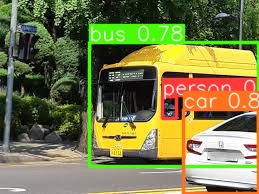

In [ ]:
#세번째 예측 이미지 display
#with Image.open('/content/runs/detect/predict/test1.jpg') as pred_image:
with Image.open("/content/runs/detect/predict/bus.jpg") as pred_img3:
  display(pred_img3)

In [ ]:
#결과 확인하기

import numpy as np

results = results1 + results1
for result in results:

    uniq, cnt = np.unique(result.boxes.cls.cpu().numpy(), return_counts=True)  # Torch.Tensor -> numpy
    uniq_cnt_dict = dict(zip(uniq, cnt))

    print('\n{class num:counts} =', ,'\n')

    for c in result.boxes.cls:
        print('class num =', int(c), ', class_name =',  )



{class num:counts} = {0.0: 6} 

class num = 0 , class_name = person
class num = 0 , class_name = person
class num = 0 , class_name = person
class num = 0 , class_name = person
class num = 0 , class_name = person
class num = 0 , class_name = person

{class num:counts} = {0.0: 2, 7.0: 1, 17.0: 1} 

class num = 17 , class_name = horse
class num = 0 , class_name = person
class num = 7 , class_name = truck
class num = 0 , class_name = person

{class num:counts} = {41.0: 2, 45.0: 1, 48.0: 2, 60.0: 1} 

class num = 48 , class_name = sandwich
class num = 60 , class_name = dining table
class num = 41 , class_name = cup
class num = 41 , class_name = cup
class num = 45 , class_name = bowl
class num = 48 , class_name = sandwich


# YOLO SEGMENT

In [ ]:
#YOLO 모듈 가져오기
from ultralytics import YOLO

# MS COCO 데이터셋 사전학습된 yolov8 모델 로드함
model1 = YOLO("yolov8n-seg.pt")

In [ ]:
results1 = model1.predict(source="*.jpg", save=True)
results2 = model1.predict(source="*.png", save=True)


image 1/3 /content/b.jpg: 384x640 (no detections), 238.1ms
image 2/3 /content/bus.jpg: 480x640 1 person, 1 car, 1 bus, 213.4ms
image 3/3 /content/kitten.jpg: 448x640 1 cat, 219.4ms
Speed: 3.4ms preprocess, 223.6ms inference, 7.7ms postprocess per image at shape (1, 3, 448, 640)
Results saved to runs/segment/predict

image 1/2 /content/frog.png: 640x640 (no detections), 284.1ms
image 2/2 /content/plane.png: 384x640 1 airplane, 170.5ms
Speed: 3.3ms preprocess, 227.3ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)
Results saved to runs/segment/predict


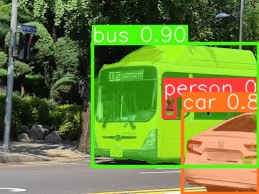

In [ ]:
with Image.open("/content/runs/segment/predict/bus.jpg") as pred_img:
  display(pred_img)

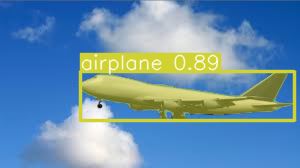

In [ ]:
with Image.open("/content/runs/segment/predict/plane.png") as pred_img2:
  display(pred_img2)